# Sprint Seq2Seq
系列データに関する手法の基本的な活用例としては機械翻訳があります。これは系列データを入力し、系列データを出力する Sequence to Sequence の手法によって行えます。

## 【問題1】機械翻訳の実行とコードリーディング
Keras公式のサンプルコードで、短い英語からフランス語への変換を行うものが公開されています。これを動かしてください。<br>
<br>
[keras/lstm_seq2seq.py at master · keras-team/keras](https://github.com/keras-team/keras/blob/master/examples/lstm_seq2seq.py)<br>
<br>
その上でこのサンプルコードの各部分がどういった役割かを読み取り、まとめてください。以下のようにどこからどこの行が何をしているかを記述してください。

（例）

- 51から55行目 : ライブラリのimport
- 57から62行目 : ハイパーパラメータの設定

#### 《文字単位のトークン化》

この実装ではテキストのベクトル化の際に、単語ではなく文字ごとを1つのトークンとして扱っています。<br>
<br>
scikit-learnでBoWを計算するCountVectorizerの場合では、デフォルトの引数はanalyzer=’word’で単語を扱いますが、charやchar_wbとすることで文字を扱えるようになります。<br>
<br>
charとchar_wbの2種類の方法があり、char_wbを指定した場合、n_gramが単語内からのみ作成されます。逆にcharは単語の区切りが関係なくn_gramが作成されます。This movie is very good.というテキストを3-gramでカウントする時、charではs mやe iといった単語をまたぐ数え方もしますが、char_wbではこれらを見ません。<br>
<br>
[sklearn.feature_extraction.text.CountVectorizer — scikit-learn 0.21.3 documentation](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html)

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
cd /content/drive/'My Drive'/Data

/content/drive/My Drive/Data


In [ ]:
!wget http://www.manythings.org/anki/fra-eng.zip

--2020-07-07 04:44:30--  http://www.manythings.org/anki/fra-eng.zip
Resolving www.manythings.org (www.manythings.org)... 104.24.108.196, 104.24.109.196, 172.67.173.198, ...
Connecting to www.manythings.org (www.manythings.org)|104.24.108.196|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6041598 (5.8M) [application/zip]
Saving to: ‘fra-eng.zip’

fra-eng.zip         100%[===================>]   5.76M  4.54MB/s    in 1.3s    

2020-07-07 04:44:31 (4.54 MB/s) - ‘fra-eng.zip’ saved [6041598/6041598]



In [ ]:
!unzip fra-eng.zip -d fra-eng

Archive:  /content/drive/My Drive/Data/fra-eng.zip
replace fra-eng/_about.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: fra-eng/_about.txt      
replace fra-eng/fra.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: fra-eng/fra.txt         


In [ ]:
!cat fra-eng/_about.txt

** Info **

Check for newest version here:
  http://www.manythings.org/anki/
Date of this file:
  2020-06-28

This data is from the sentences_detailed.csv file from tatoeba.org.
http://tatoeba.org/files/downloads/sentences_detailed.csv



** Terms of Use **

See the terms of use.
These files have been released under the same license as the
source.

http://tatoeba.org/eng/terms_of_use
http://creativecommons.org/licenses/by/2.0

Attribution: www.manythings.org/anki and tatoeba.org



** Warnings ** 

The data from the Tatoeba Project contains errors.

To lower the number of errors you are likely to see, only
sentences by native speakers and proofread sentences have
been included.

For the non-English language, I made these (possibly wrong)
assumptions.
Assumption 1: Sentences written by native speakers can be
trusted.
Assumption 2: Contributors to the Tatoeba Project are honest
about what their native language is.

For English, I used the sentences that I have proofread
and thought were 

In [ ]:
from __future__ import print_function

from keras.models import Model
from keras.layers import Input, LSTM, Dense
import numpy as np

batch_size = 64  # Batch size for training.
epochs = 100  # Number of epochs to train for.
latent_dim = 256  # Latent dimensionality of the encoding space.
num_samples = 10000  # Number of samples to train on.
# Path to the data txt file on disk.
data_path = 'fra-eng/fra.txt'

# Vectorize the data.
input_texts = []
target_texts = []
input_characters = set()
target_characters = set()
with open(data_path, 'r', encoding='utf-8') as f:
    lines = f.read().split('\n')
for line in lines[: min(num_samples, len(lines) - 1)]:
    input_text, target_text, _ = line.split('\t')
    # We use "tab" as the "start sequence" character
    # for the targets, and "\n" as "end sequence" character.
    target_text = '\t' + target_text + '\n'
    input_texts.append(input_text)
    target_texts.append(target_text)
    for char in input_text:
        if char not in input_characters:
            input_characters.add(char)
    for char in target_text:
        if char not in target_characters:
            target_characters.add(char)

input_characters = sorted(list(input_characters))
target_characters = sorted(list(target_characters))
num_encoder_tokens = len(input_characters)
num_decoder_tokens = len(target_characters)
max_encoder_seq_length = max([len(txt) for txt in input_texts])
max_decoder_seq_length = max([len(txt) for txt in target_texts])

print('Number of samples:', len(input_texts))
print('Number of unique input tokens:', num_encoder_tokens)
print('Number of unique output tokens:', num_decoder_tokens)
print('Max sequence length for inputs:', max_encoder_seq_length)
print('Max sequence length for outputs:', max_decoder_seq_length)

input_token_index = dict(
    [(char, i) for i, char in enumerate(input_characters)])
target_token_index = dict(
    [(char, i) for i, char in enumerate(target_characters)])

encoder_input_data = np.zeros(
    (len(input_texts), max_encoder_seq_length, num_encoder_tokens),
    dtype='float32')
decoder_input_data = np.zeros(
    (len(input_texts), max_decoder_seq_length, num_decoder_tokens),
    dtype='float32')
decoder_target_data = np.zeros(
    (len(input_texts), max_decoder_seq_length, num_decoder_tokens),
    dtype='float32')

for i, (input_text, target_text) in enumerate(zip(input_texts, target_texts)):
    for t, char in enumerate(input_text):
        encoder_input_data[i, t, input_token_index[char]] = 1.
    encoder_input_data[i, t + 1:, input_token_index[' ']] = 1.
    for t, char in enumerate(target_text):
        # decoder_target_data is ahead of decoder_input_data by one timestep
        decoder_input_data[i, t, target_token_index[char]] = 1.
        if t > 0:
            # decoder_target_data will be ahead by one timestep
            # and will not include the start character.
            decoder_target_data[i, t - 1, target_token_index[char]] = 1.
    decoder_input_data[i, t + 1:, target_token_index[' ']] = 1.
    decoder_target_data[i, t:, target_token_index[' ']] = 1.
# Define an input sequence and process it.
encoder_inputs = Input(shape=(None, num_encoder_tokens))
encoder = LSTM(latent_dim, return_state=True)
encoder_outputs, state_h, state_c = encoder(encoder_inputs)
# We discard `encoder_outputs` and only keep the states.
encoder_states = [state_h, state_c]

# Set up the decoder, using `encoder_states` as initial state.
decoder_inputs = Input(shape=(None, num_decoder_tokens))
# We set up our decoder to return full output sequences,
# and to return internal states as well. We don't use the
# return states in the training model, but we will use them in inference.
decoder_lstm = LSTM(latent_dim, return_sequences=True, return_state=True)
decoder_outputs, _, _ = decoder_lstm(decoder_inputs,
                                     initial_state=encoder_states)
decoder_dense = Dense(num_decoder_tokens, activation='softmax')
decoder_outputs = decoder_dense(decoder_outputs)

# Define the model that will turn
# `encoder_input_data` & `decoder_input_data` into `decoder_target_data`
model = Model([encoder_inputs, decoder_inputs], decoder_outputs)

# Run training
model.compile(optimizer='rmsprop', loss='categorical_crossentropy',
              metrics=['accuracy'])
model.fit([encoder_input_data, decoder_input_data], decoder_target_data,
          batch_size=batch_size,
          epochs=epochs,
          validation_split=0.2)
# Save model
model.save('s2s.h5')

# Next: inference mode (sampling).
# Here's the drill:
# 1) encode input and retrieve initial decoder state
# 2) run one step of decoder with this initial state
# and a "start of sequence" token as target.
# Output will be the next target token
# 3) Repeat with the current target token and current states

# Define sampling models
encoder_model = Model(encoder_inputs, encoder_states)

decoder_state_input_h = Input(shape=(latent_dim,))
decoder_state_input_c = Input(shape=(latent_dim,))
decoder_states_inputs = [decoder_state_input_h, decoder_state_input_c]
decoder_outputs, state_h, state_c = decoder_lstm(
    decoder_inputs, initial_state=decoder_states_inputs)
decoder_states = [state_h, state_c]
decoder_outputs = decoder_dense(decoder_outputs)
decoder_model = Model(
    [decoder_inputs] + decoder_states_inputs,
    [decoder_outputs] + decoder_states)

# Reverse-lookup token index to decode sequences back to
# something readable.
reverse_input_char_index = dict(
    (i, char) for char, i in input_token_index.items())
reverse_target_char_index = dict(
    (i, char) for char, i in target_token_index.items())


def decode_sequence(input_seq):
    # Encode the input as state vectors.
    states_value = encoder_model.predict(input_seq)

    # Generate empty target sequence of length 1.
    target_seq = np.zeros((1, 1, num_decoder_tokens))
    # Populate the first character of target sequence with the start character.
    target_seq[0, 0, target_token_index['\t']] = 1.

    # Sampling loop for a batch of sequences
    # (to simplify, here we assume a batch of size 1).
    stop_condition = False
    decoded_sentence = ''
    while not stop_condition:
        output_tokens, h, c = decoder_model.predict(
            [target_seq] + states_value)

        # Sample a token
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_char = reverse_target_char_index[sampled_token_index]
        decoded_sentence += sampled_char

        # Exit condition: either hit max length
        # or find stop character.
        if (sampled_char == '\n' or
           len(decoded_sentence) > max_decoder_seq_length):
            stop_condition = True

        # Update the target sequence (of length 1).
        target_seq = np.zeros((1, 1, num_decoder_tokens))
        target_seq[0, 0, sampled_token_index] = 1.

        # Update states
        states_value = [h, c]

    return decoded_sentence


for seq_index in range(100):
    # Take one sequence (part of the training set)
    # for trying out decoding.
    input_seq = encoder_input_data[seq_index: seq_index + 1]
    decoded_sentence = decode_sequence(input_seq)
    print('-')
    print('Input sentence:', input_texts[seq_index])
    print('Decoded sentence:', decoded_sentence)

Number of samples: 10000
Number of unique input tokens: 71
Number of unique output tokens: 92
Max sequence length for inputs: 16
Max sequence length for outputs: 59
Train on 8000 samples, validate on 2000 samples
Epoch 1/100
8000/8000 [==============================] - 16s 2ms/step - loss: 1.1682 - accuracy: 0.7262 - val_loss: 1.0440 - val_accuracy: 0.7122
Epoch 2/100
8000/8000 [==============================] - 15s 2ms/step - loss: 0.8499 - accuracy: 0.7714 - val_loss: 0.8356 - val_accuracy: 0.7705
Epoch 3/100
8000/8000 [==============================] - 15s 2ms/step - loss: 0.6844 - accuracy: 0.8077 - val_loss: 0.7239 - val_accuracy: 0.7908
Epoch 4/100
8000/8000 [==============================] - 15s 2ms/step - loss: 0.5975 - accuracy: 0.8270 - val_loss: 0.6700 - val_accuracy: 0.8053
Epoch 5/100
8000/8000 [==============================] - 15s 2ms/step - loss: 0.5479 - accuracy: 0.8397 - val_loss: 0.6213 - val_accuracy: 0.8185
Epoch 6/100
8000/8000 [==============================] - 

### イメージキャプショニング
他の活用例としてイメージキャプショニングがあります。画像に対する説明の文章を推定するタスクです。これは画像を入力し、系列データを出力する Image to Sequence の手法によって行えます。

[pytorch-tutorial/tutorials/03-advanced/image_captioning at master · yunjey/pytorch-tutorial](https://github.com/yunjey/pytorch-tutorial/tree/master/tutorials/03-advanced/image_captioning)

イメージキャプショニングは学習に多くの時間がかかるため、ここでは学習済みの重みが公開されている実装を動かすことにします。Kerasには平易に扱える実装が公開されていないため、今回はPyTorchによる実装を扱います。

## 【問題2】イメージキャプショニングの学習済みモデルの実行
上記実装において 5. Test the model の項目を実行してください。また、自身で用意した画像に対しても文章を生成してください。これらに対してどういった文章が出力されたかを記録して提出してください。

データセットからの学習は行わず、学習済みの重みをダウンロードして利用します。

注意点として、デフォルトで設定されている重みのファイル名と、ダウンロードできる重みのファイル名は異なっています。ここは書き換える必要があります。

In [ ]:
cd /content/drive/'My Drive'/Git/

/content/drive/My Drive/Git


In [ ]:
!git clone https://github.com/yunjey/pytorch-tutorial.git

Cloning into 'pytorch-tutorial'...
remote: Enumerating objects: 917, done.
remote: Total 917 (delta 0), reused 0 (delta 0), pack-reused 917
Receiving objects: 100% (917/917), 12.80 MiB | 12.14 MiB/s, done.
Resolving deltas: 100% (490/490), done.


In [ ]:
cd /content/drive/My Drive/Git/pytorch-tutorial/tutorials/03-advanced/image_captioning/

/content/drive/My Drive/Git/pytorch-tutorial/tutorials/03-advanced/image_captioning


In [ ]:
# Download pretrained model
# If you do not want to train the model from scratch, you can use a pretrained model.
# You should extract pretrained_model.zip to ./models/ and vocap.zip to ./data/ using unzip command.
!wget https://www.dropbox.com/s/ne0ixz5d58ccbbz/pretrained_model.zip
!wget https://www.dropbox.com/s/26adb7y9m98uisa/vocap.zip

--2020-07-07 05:03:35--  https://www.dropbox.com/s/ne0ixz5d58ccbbz/pretrained_model.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.1, 2620:100:6021:1::a27d:4101
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/ne0ixz5d58ccbbz/pretrained_model.zip [following]
--2020-07-07 05:03:35--  https://www.dropbox.com/s/raw/ne0ixz5d58ccbbz/pretrained_model.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uce34c474d1be992b2fca9796a12.dl.dropboxusercontent.com/cd/0/inline/A7AIFF4mpP2ZtqYMT4HHEFFsnWBDyGQmh-Y5sFS0VMAx3ZPzFE8l2NTmBytBgDpb10CeXJNEBfnyCDzRL_8E68s3oAR9T5_Gwos6zGW9BuOgdY6f6zRUaxxR7I16ai66Tqc/file# [following]
--2020-07-07 05:03:35--  https://uce34c474d1be992b2fca9796a12.dl.dropboxusercontent.com/cd/0/inline/A7AIFF4mpP2ZtqYMT4HHEFFsnWBDyGQmh-Y5sFS0VMAx3ZPzFE8l2NTmBytBgDpb10CeXJNEBfnyCDzRL_8E68s

In [ ]:
!unzip pretrained_model.zip -d ./models/
!unzip vocap.zip -d ./data/ 

Archive:  pretrained_model.zip
  inflating: ./models/encoder-5-3000.pkl  
  inflating: ./models/decoder-5-3000.pkl  
Archive:  vocap.zip
  inflating: ./data/vocab.pkl        


In [ ]:
!python sample.py --image='png/example.png'

<start> a group of giraffes standing next to each other . <end>


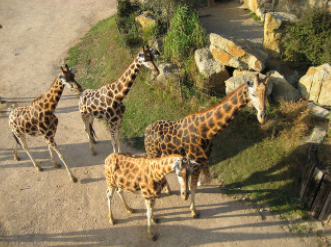

In [ ]:
# 画像を確認
from PIL import Image
Image.open('png/example.png')

In [ ]:
!python sample.py --image='/content/drive/My Drive/Data/IMG_7319.png'

<start> a bunch of fruit stand in a market . <end>


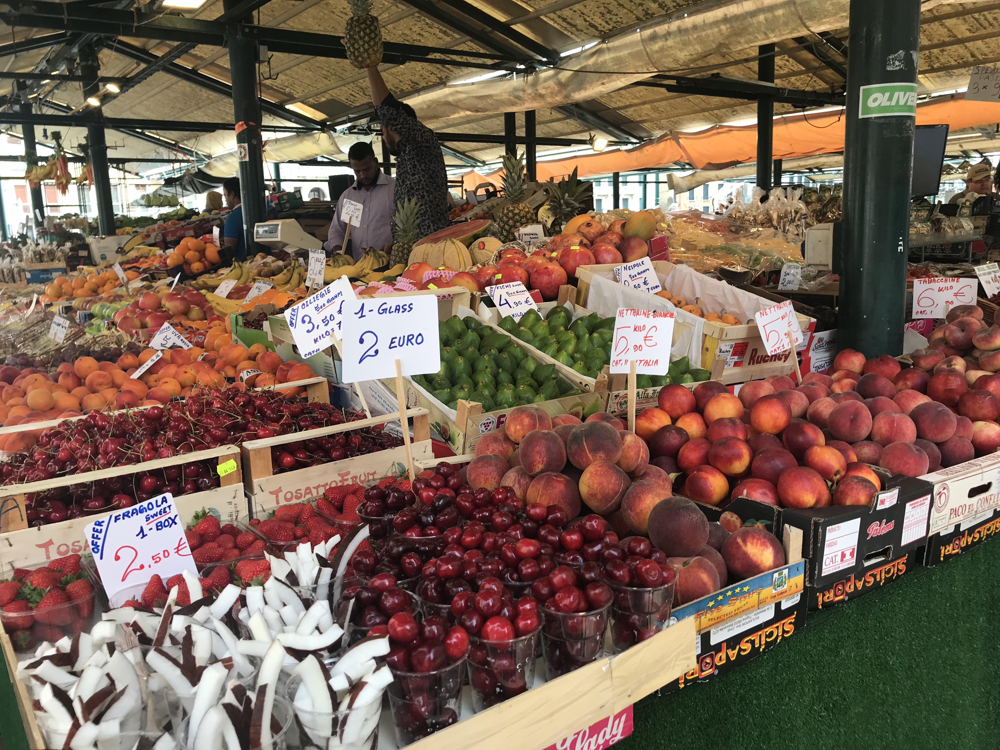

In [ ]:
Image.open('/content/drive/My Drive/Data/IMG_7319.png')

## 【問題3】Kerasで動かしたい場合はどうするかを調査
PyTorchによる実装を動かしましたが、何らかの理由からKerasで動かしたい状況が考えられます。どういった手順を踏むことになるか調査し、できるだけ詳しく説明してください。

特に今回はPyTorchのための学習済みの重みをKerasで使えるようにしたいので、その点については必ず触れてください。

>Pytorchで学習させたモデルをopen neural network exchange (onnx)モジュールを使用し、onnx形式に変換する。<br>
>onnx-tensorflowを使用し、変換されたモデルを読み込む。

## 【問題4】（アドバンス課題）コードリーディングと書き換え
モデル部分はmodel.pyに書かれていますが、Kerasではこのモデルがどのように記述できるかを考え、コーディングしてください。その際機械翻訳のサンプルコードが参考になります。

>KerasのResNet152にLSTMを結合させようとしたが、LSTMのinput shapeが合わないとのこと。また、vocabulary dataのpickleを読み込むことができず、断念。

In [ ]:
from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM, BatchNormalization
from keras.applications import ResNet152
import pickle

In [ ]:
model_path= "/content/drive/My Drive/Git/pytorch-tutorial/tutorials/03-advanced/image_captioning/models/encoder-5-3000.pkl"
vocab_path = "/content/drive/My Drive/Git/pytorch-tutorial/tutorials/03-advanced/image_captioning/data/vocab.pkl"

# Load encoder model
with open(model_path, 'rb') as f:
    enc_model = pickle.load(f)

In [ ]:
# Load vocabulary wrapper
with open(vocab_path, 'rb') as f:
    vocab = pickle.load(f)

AttributeError: ignored

In [ ]:
embed_size = 256 # default setting
hidden_size = 512 # default setting
vocab_size = 10

model = Sequential()
# encoder
model.add(ResNet152(
    include_top=False, # delete last FC layer
    weights="imagenet",
    # input_tensor=None,
    # input_shape=None,
    # pooling=None,
    # classes=1000,
    ))
model.add(Dense(2048))
model.add(BatchNormalization())
# decoder
model.add(Embedding(vocab_size, 256))
model.add(LSTM(20)) # max_seq_length
model.add(Dense(vocab_size))

model.summary()

ValueError: ignored

In [ ]:
models.resnet152(pretrained=True).fc.in_features

Downloading: "https://download.pytorch.org/models/resnet152-b121ed2d.pth" to /root/.cache/torch/checkpoints/resnet152-b121ed2d.pth


2048

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
from torch.nn.utils.rnn import pack_padded_sequence


class EncoderCNN(nn.Module):
    def __init__(self, embed_size):
        """Load the pretrained ResNet-152 and replace top fc layer."""
        super(EncoderCNN, self).__init__()
        resnet = models.resnet152(pretrained=True)
        modules = list(resnet.children())[:-1]      # delete the last fc layer.
        self.resnet = nn.Sequential(*modules)
        self.linear = nn.Linear(resnet.fc.in_features, embed_size)
        self.bn = nn.BatchNorm1d(embed_size, momentum=0.01)
        
    def forward(self, images):
        """Extract feature vectors from input images."""
        with torch.no_grad():
            features = self.resnet(images)
        features = features.reshape(features.size(0), -1)
        features = self.bn(self.linear(features))
        return features


class DecoderRNN(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers, max_seq_length=20):
        """Set the hyper-parameters and build the layers."""
        super(DecoderRNN, self).__init__()
        self.embed = nn.Embedding(vocab_size, embed_size)
        self.lstm = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True)
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.max_seg_length = max_seq_length
        
    def forward(self, features, captions, lengths):
        """Decode image feature vectors and generates captions."""
        embeddings = self.embed(captions)
        embeddings = torch.cat((features.unsqueeze(1), embeddings), 1)
        packed = pack_padded_sequence(embeddings, lengths, batch_first=True) 
        hiddens, _ = self.lstm(packed)
        outputs = self.linear(hiddens[0])
        return outputs
    
    def sample(self, features, states=None):
        """Generate captions for given image features using greedy search."""
        sampled_ids = []
        inputs = features.unsqueeze(1)
        for i in range(self.max_seg_length):
            hiddens, states = self.lstm(inputs, states)          # hiddens: (batch_size, 1, hidden_size)
            outputs = self.linear(hiddens.squeeze(1))            # outputs:  (batch_size, vocab_size)
            _, predicted = outputs.max(1)                        # predicted: (batch_size)
            sampled_ids.append(predicted)
            inputs = self.embed(predicted)                       # inputs: (batch_size, embed_size)
            inputs = inputs.unsqueeze(1)                         # inputs: (batch_size, 1, embed_size)
        sampled_ids = torch.stack(sampled_ids, 1)                # sampled_ids: (batch_size, max_seq_length)
        return sampled_ids

## 【問題5】（アドバンス課題）発展的調査
《他の言語の翻訳を行う場合は？》

問題1の実装を使い日本語と英語の翻訳を行いたい場合はどのような手順を踏むか考えてみましょう。

《機械翻訳の発展的手法にはどのようなものがある？》

機械翻訳のための発展的手法にはどういったものがあるか調査してみましょう。

《文章から画像生成するには？》

イメージキャプショニングとは逆に文章から画像を生成する手法もあります。どういったものがあるか調査してみましょう。